In [1]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
%%bash
if [ ! -d ".git" ]; then
    rm -rf * .*; #Get rid of Colab's default junk files
    git clone -b master https://github.com/Firefly2024/Diffusion-Illusions .
fi

In [3]:
%pip install --upgrade -r requirements.txt
%pip install rp --upgrade
# You may need to restart the runtime after installing these
# I'm not sure why this helps, but all sorts of weird random errors pop up in Colab if you don't

In [4]:
import numpy as np
import rp
import torch
import torch.nn as nn
import source.stable_diffusion_with_images as sd
from easydict import EasyDict
from source.learnable_textures import LearnableImageFourier
from source.stable_diffusion_labels import NegativeLabel
from itertools import chain
from PIL import Image
import matplotlib.pyplot as plt
import time

%matplotlib inline

Available example prompts: kitten_in_box, botw_landscape, magic_emma_watson, yorkshire_terrier_santa, norwegian_winter_girl, magic_forest_temple, sailing_ship, bioshock_lighthouse, two_bunnys_hugging, thomas_tank_military, wolf_on_rock, victorial_dress, lolita_dress_magical_elf, pencil_giraffe_head, pencil_penguin, pencil_violin, pencil_orca_whale, pencil_cow, pencil_walrus, pencil_cat_head, pencil_dog_head, ape_with_gun, human_skeleton, gold_coins, golf_ball_in_forest, bear_in_forest, elephant_in_circus, mickey_mouse, mushroom, mario, burger, darth_vader, gandalf, fantasy_city, green_elf_girl, pikachu, spring, fall, winter, summer, miku, pyramids, dinosaur, lipstick, picard, bull_wing, froggo, assasin_creed, moon, minecraft_zombie, pistol, disco_ball, volcano, porche, hawaii_beach, walter_white, dalek, tardis, tennant, weeping_angel

Negative prompt: ''

Chosen prompts:
    prompt_a = 'A hamburger'
    prompt_b = 'A bottle of Coco Cola'
    prompt_c = 'A plate of French fries'
    pro

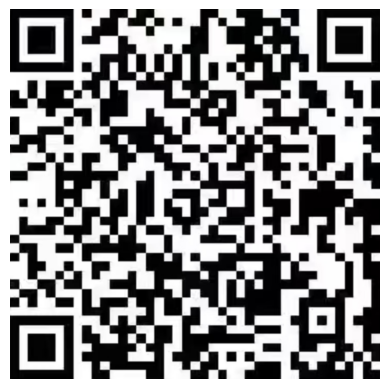

In [5]:
#ONLY GOOD PROMPTS HERE
example_prompts = rp.load_yaml_file('source/example_prompts.yaml')
print('Available example prompts:', ', '.join(example_prompts))

#These prompts are all strings - you can replace them with whatever you want! By default it lets you choose from example prompts
# prompt_a, prompt_b, prompt_c, prompt_d, prompt_z = rp.gather(example_prompts, 'miku froggo lipstick kitten_in_box darth_vader'.split())
#Prompts a,b,c,d are the normal looking images
#Prompt z is the hidden image you get when you overlay them all on top of each other

prompt_a = 'A hamburger'
prompt_b = 'A bottle of Coco Cola'
prompt_c = 'A plate of French fries'
prompt_d = 'A pair of grilled chicken wings'
prompt_z = '' 

img_path = 'example_images/thurs.png' # The image to be hidden, you can change it to whatever you want

negative_prompt = ''

print()
print('Negative prompt:', repr(negative_prompt))
print()
print('Chosen prompts:')
print('    prompt_a =', repr(prompt_a))
print('    prompt_b =', repr(prompt_b))
print('    prompt_c =', repr(prompt_c))
print('    prompt_d =', repr(prompt_d))

print('Hidden image:')
img = Image.open(img_path)
plt.imshow(img)
plt.axis('off')
plt.show()

# New Section

In [6]:
if 's' not in dir():
    model_name="CompVis/stable-diffusion-v1-4"
    gpu='cuda:0'
    s=sd.StableDiffusion(gpu,model_name)
device=s.device

[INFO] sd.py: loading stable diffusion...please make sure you have run `huggingface-cli login`.


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/open_clip/factory.py:380: UserWarning: These pretrained weights were trained with QuickGELU activation but the model config does not have that enabled. Consider using a model config with a "-quickgelu" suffix or enable with a flag.
  warnings.warn(


[INFO] sd.py: loaded stable diffusion!


In [7]:
label_a = NegativeLabel(prompt_a,negative_prompt)
label_b = NegativeLabel(prompt_b,negative_prompt)
label_c = NegativeLabel(prompt_c,negative_prompt)
label_d = NegativeLabel(prompt_d,negative_prompt)
label_z = NegativeLabel(prompt_z,negative_prompt)

s.prepare_image(img_path)

In [8]:
#Image Parametrization and Initialization (this section takes vram)

#Select Learnable Image Size (this has big VRAM implications!):
#Note: We use implicit neural representations for better image quality
#They're previously used in our paper "TRITON: Neural Neural Textures make Sim2Real Consistent" (see tritonpaper.github.io)
# ... and that representation is based on Fourier Feature Networks (see bmild.github.io/fourfeat)
learnable_image_maker = lambda: LearnableImageFourier(height=256, width=256, hidden_dim=256, num_features=128).to(s.device); SIZE=256
# learnable_image_maker = lambda: LearnableImageFourier(height=512,width=512,num_features=256,hidden_dim=256,scale=20).to(s.device);SIZE=512

image_a=learnable_image_maker()
image_b=learnable_image_maker()
image_c=learnable_image_maker()
image_d=learnable_image_maker()

In [9]:
CLEAN_MODE = True # If it's False, we augment the images by randomly simulating how good a random printer might be when making the overlays...

def simulate_overlay(a,b,c,d):
    if CLEAN_MODE:
        exp=1
        brightness=3
        black=0
    else:
        exp=rp.random_float(.5,1)
        brightness=rp.random_float(1,5)
        black=rp.random_float(0,.5)
        bottom=rp.blend(bottom,black,rp.random_float())
        top=rp.blend(top,black,rp.random_float())
    return (a**exp * b**exp *c**exp * d**exp * brightness).clamp(0,99).tanh()

learnable_image_a=lambda: image_a()
learnable_image_b=lambda: image_b()
learnable_image_c=lambda: image_c()
learnable_image_d=lambda: image_d()
learnable_image_z=lambda: simulate_overlay(image_a(), image_b(), image_c(), image_d())

params=chain(
    image_a.parameters(),
    image_b.parameters(),
    image_c.parameters(),
    image_d.parameters(),
)
optim=torch.optim.SGD(params,lr=1e-4)

In [10]:
labels=[label_a, label_b, label_c, label_d, label_z]
learnable_images=[learnable_image_a,learnable_image_b,learnable_image_c,learnable_image_d,learnable_image_z]

#The weight coefficients for each prompt. For example, if we have [1,1,1,1,5], then the hidden prompt (prompt_z) will be prioritized
weights=[1,1,1,1,0]
# The default weight of prompt_z is set to 0, indicating that the generated hidden image is not intended to be influenced by the text prompt. However, if you wish to constrain the generated image using text in prompt_z, you can add prompt_z and adjust the subsequent weight accordingly.

weights=rp.as_numpy_array(weights)
weights=weights/weights.sum()
weights=weights*len(weights)

In [11]:
#For saving a timelapse
ims=[]

In [12]:
def get_display_image():
    return rp.tiled_images(
        [
            *[rp.as_numpy_image(image()) for image in learnable_images[:-1]],
            rp.as_numpy_image(learnable_image_z()),
        ],
        length=len(learnable_images),
        border_thickness=0,
    )

Every 200 iterations we display an image in the form [image_a, image_b, image_c, image_d, image_z] where
    image_z = image_a * image_b * image_c * image_d

Interrupt the kernel at any time to return the currently displayed image
You can run this cell again to resume training later on

Please expect this to take hours to get good images (especially on the slower Colab GPU's! The longer you wait the better they'll be


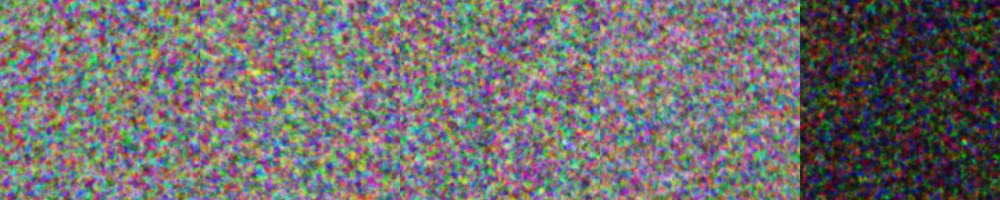

Status: : ETR=0:31:00.206868	ETA=0:31:37.976602	T=0:00:37.769734	Progress: 199/10000

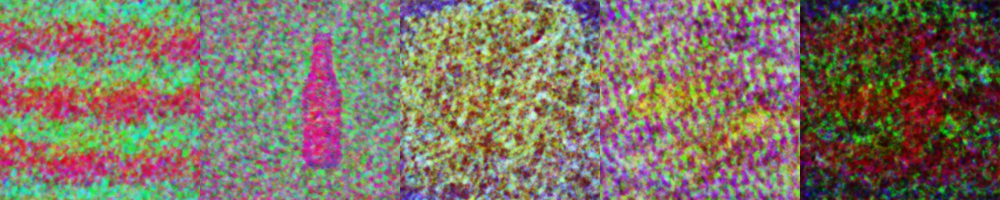

Status: : ETR=0:30:12.960431	ETA=0:31:28.303751	T=0:01:15.343320	Progress: 399/10000

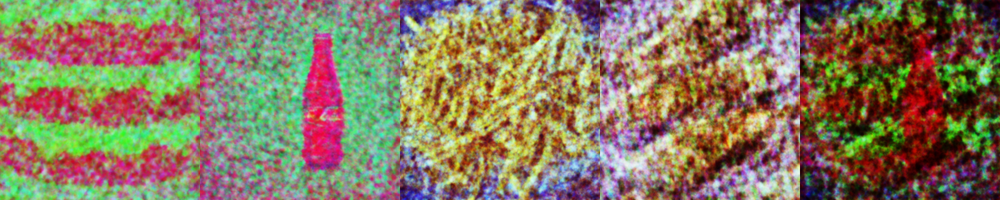

Status: : ETR=0:29:29.980879	ETA=0:31:22.758089	T=0:01:52.777210	Progress: 599/10000

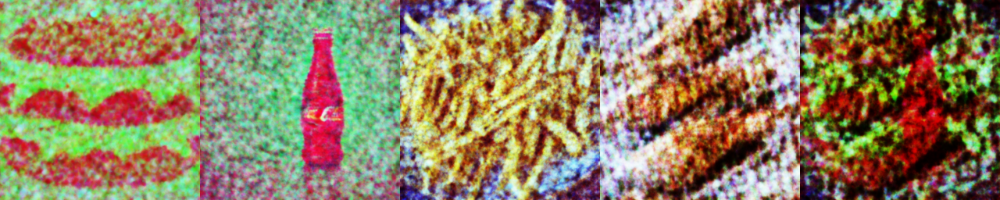

Status: : ETR=0:28:47.582512	ETA=0:31:17.602991	T=0:02:30.020479	Progress: 799/10000

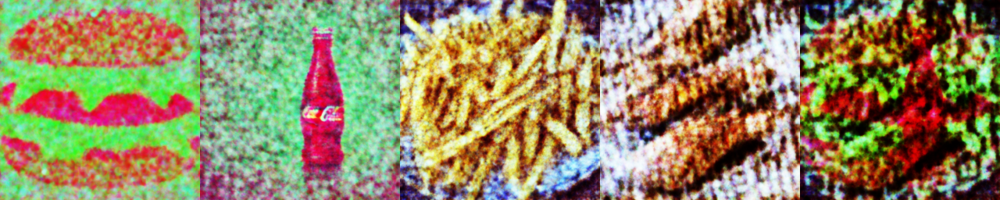

Status: : ETR=0:28:02.930678	ETA=0:31:09.715229	T=0:03:06.784551	Progress: 999/10000

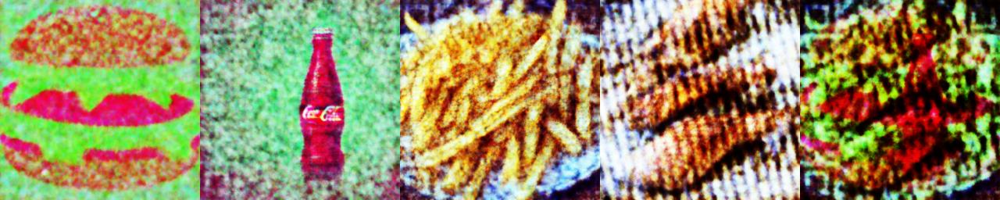

Status: : ETR=0:27:25.951548	ETA=0:31:10.186965	T=0:03:44.235417	Progress: 1199/10000

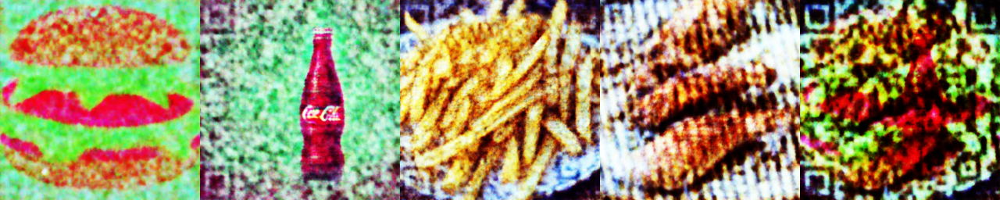

Status: : ETR=0:26:46.104903	ETA=0:31:07.346707	T=0:04:21.241804	Progress: 1399/10000

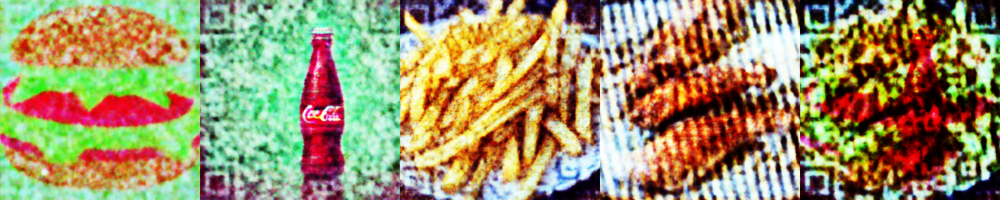

Status: : ETR=0:26:07.156120	ETA=0:31:05.439971	T=0:04:58.283851	Progress: 1599/10000

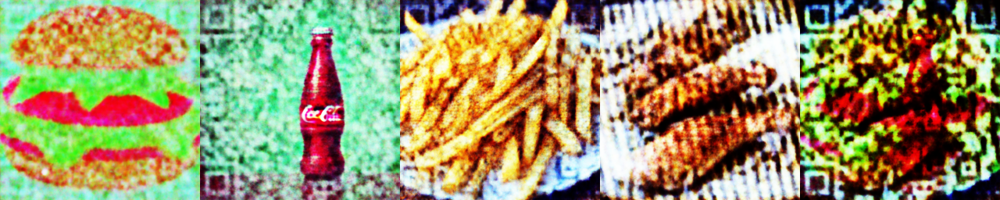

Status: : ETR=0:25:30.468440	ETA=0:31:06.197342	T=0:05:35.728902	Progress: 1799/10000

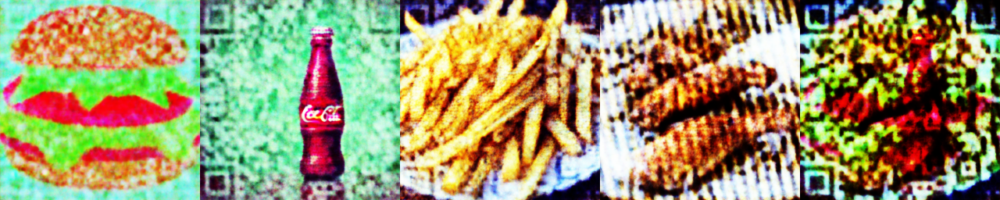

Status: : ETR=0:24:54.074894	ETA=0:31:07.360197	T=0:06:13.285303	Progress: 1999/10000

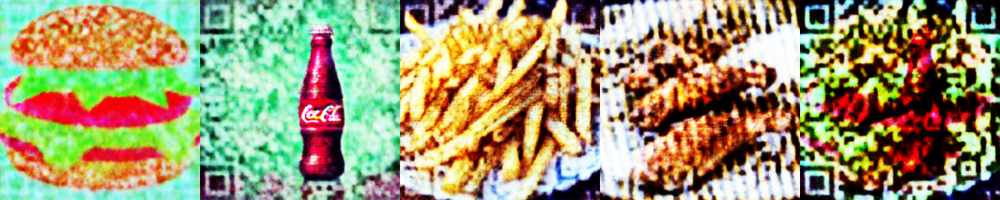

Status: : ETR=0:24:13.443177	ETA=0:31:03.149824	T=0:06:49.706646	Progress: 2199/10000

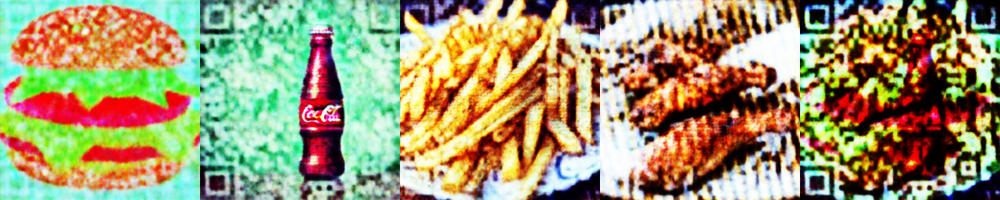

Status: : ETR=0:23:36.623677	ETA=0:31:03.733294	T=0:07:27.109617	Progress: 2399/10000

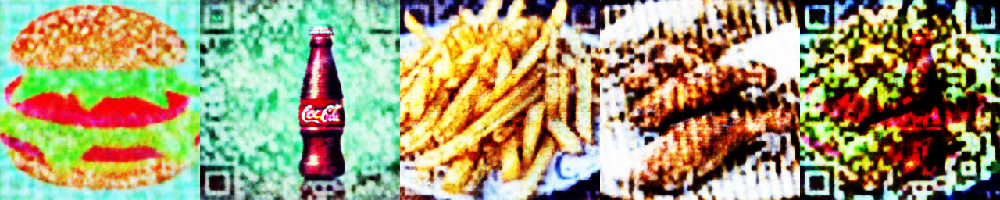

Status: : ETR=0:22:59.686935	ETA=0:31:04.189887	T=0:08:04.502952	Progress: 2599/10000

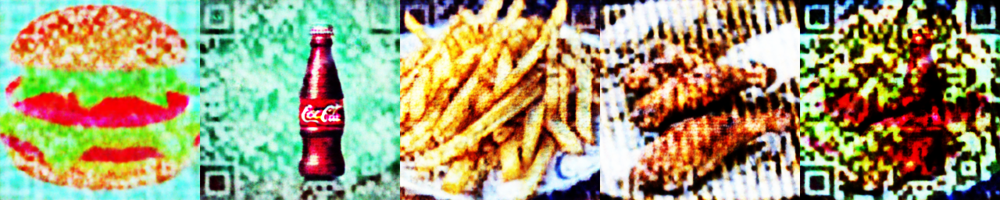

Status: : ETR=0:22:22.425814	ETA=0:31:04.221377	T=0:08:41.795563	Progress: 2799/10000

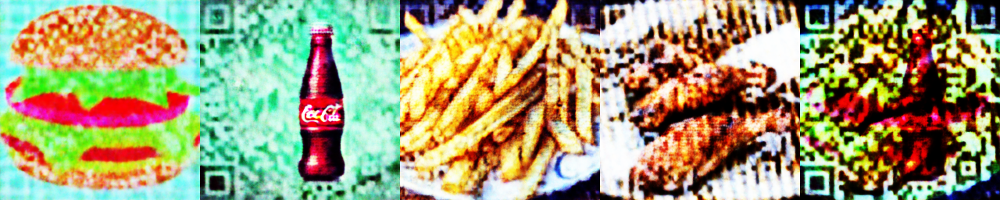

Status: : ETR=0:21:44.502886	ETA=0:31:03.309365	T=0:09:18.806479	Progress: 2999/10000

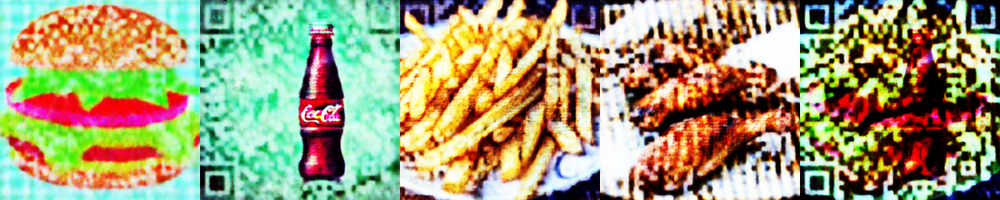

Status: : ETR=0:21:07.256138	ETA=0:31:03.337948	T=0:09:56.081810	Progress: 3199/10000

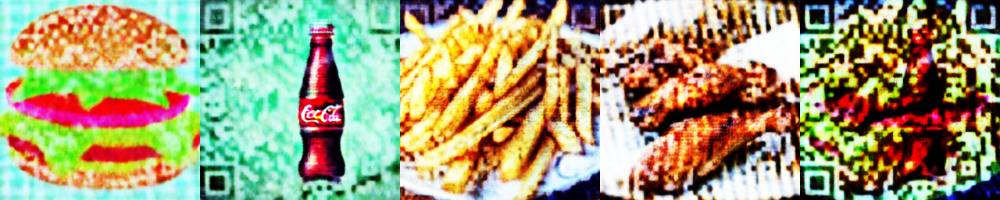

Status: : ETR=0:20:31.466712	ETA=0:31:05.575991	T=0:10:34.109279	Progress: 3399/10000

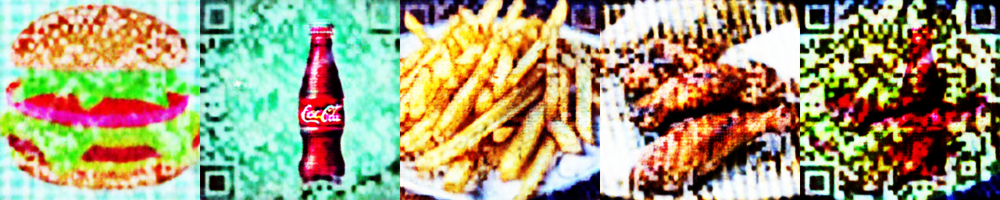

Status: : ETR=0:19:56.476981	ETA=0:31:09.495283	T=0:11:13.018302	Progress: 3600/10000

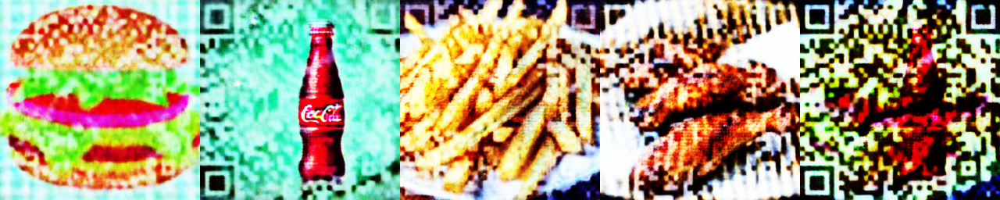

Status: : ETR=0:19:18.242351	ETA=0:31:07.831560	T=0:11:49.589210	Progress: 3799/10000

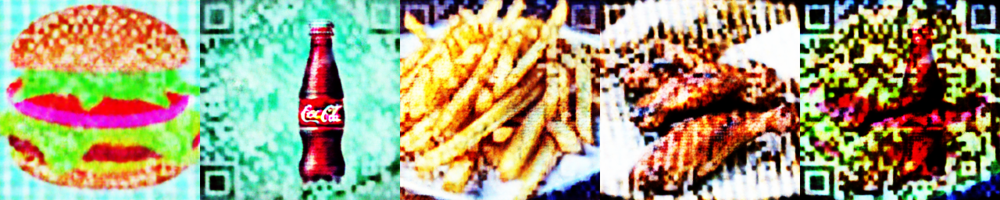

Status: : ETR=0:18:40.481157	ETA=0:31:07.157402	T=0:12:26.676245	Progress: 3999/10000

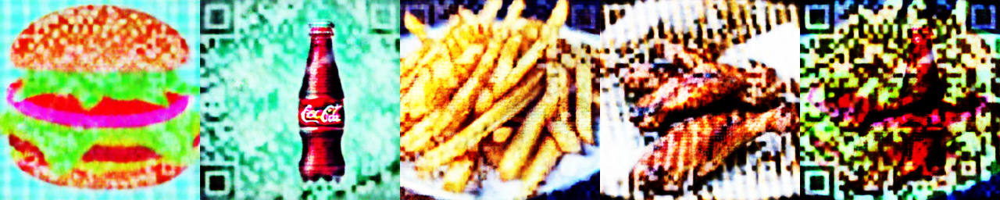

Status: : ETR=0:18:03.080739	ETA=0:31:07.058679	T=0:13:03.977939	Progress: 4199/10000

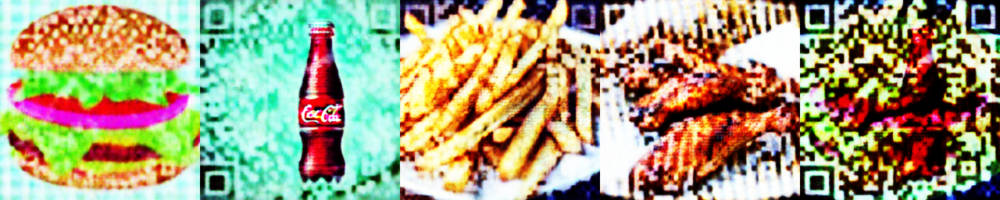

Status: : ETR=0:17:25.592382	ETA=0:31:06.795896	T=0:13:41.203515	Progress: 4399/10000

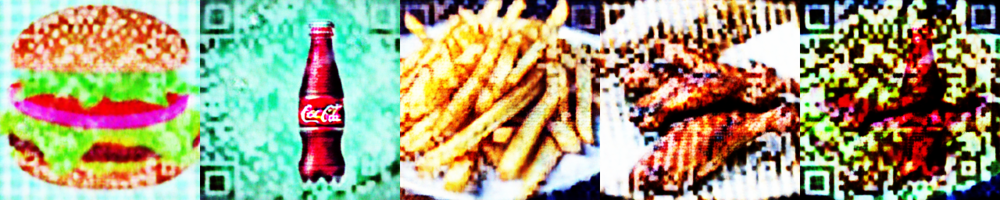

Status: : ETR=0:16:48.119254	ETA=0:31:06.541852	T=0:14:18.422598	Progress: 4599/10000

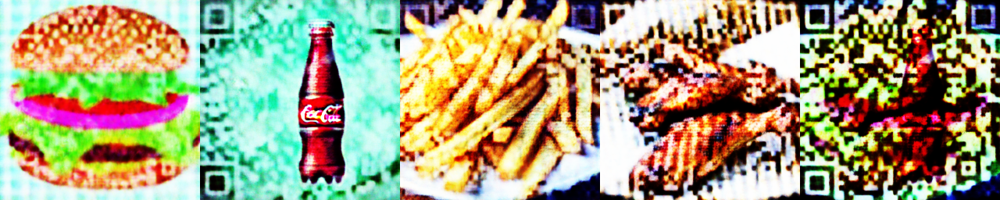

Status: : ETR=0:16:10.602827	ETA=0:31:06.185017	T=0:14:55.582190	Progress: 4799/10000

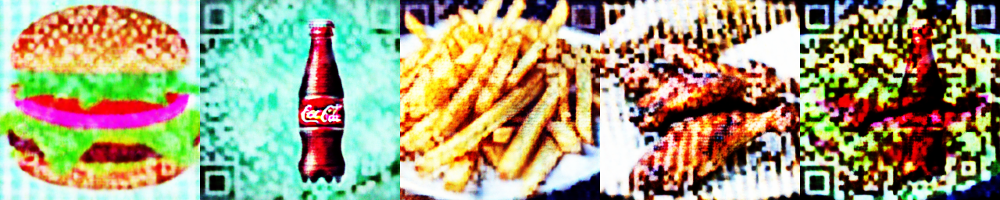

Status: : ETR=0:15:33.711201	ETA=0:31:07.048991	T=0:15:33.337791	Progress: 4999/10000

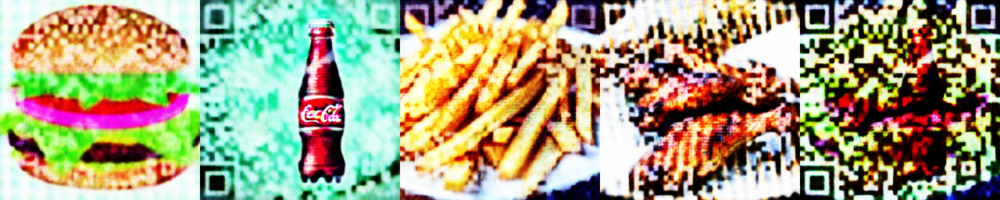

Status: : ETR=0:14:56.377005	ETA=0:31:07.063122	T=0:16:10.686117	Progress: 5199/10000

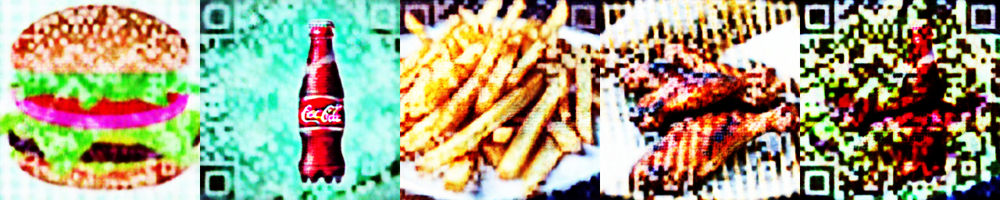

Status: : ETR=0:14:18.878019	ETA=0:31:06.720319	T=0:16:47.842300	Progress: 5399/10000

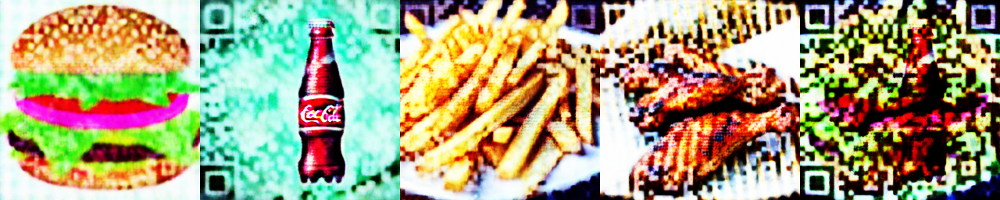

Status: : ETR=0:13:41.879279	ETA=0:31:07.483023	T=0:17:25.603745	Progress: 5599/10000

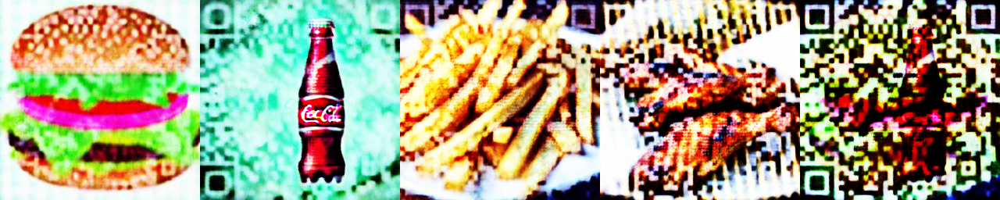

Status: : ETR=0:13:04.172910	ETA=0:31:06.633921	T=0:18:02.461011	Progress: 5799/10000

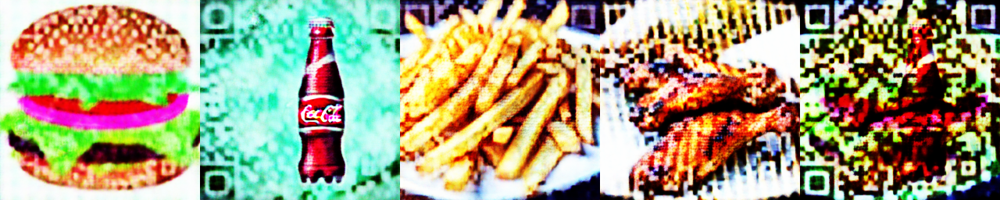

Status: : ETR=0:12:26.605916	ETA=0:31:06.048278	T=0:18:39.442362	Progress: 5999/10000

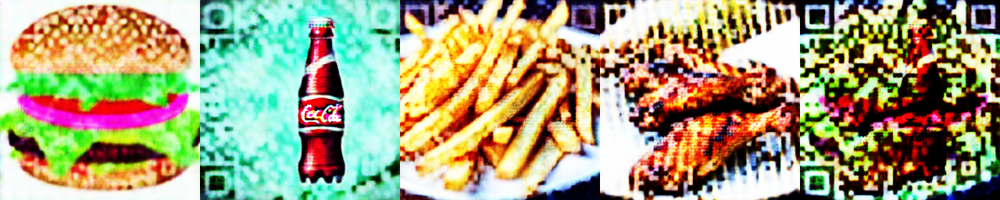

Status: : ETR=0:11:48.995938	ETA=0:31:05.287920	T=0:19:16.291981	Progress: 6199/10000

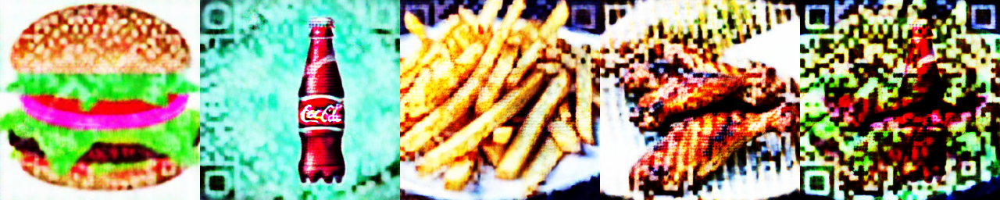

Status: : ETR=0:11:11.621905	ETA=0:31:05.098320	T=0:19:53.476415	Progress: 6399/10000

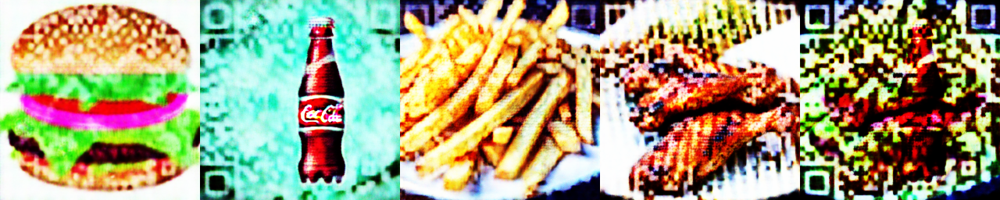

Status: : ETR=0:10:34.638587	ETA=0:31:06.035246	T=0:20:31.396659	Progress: 6599/10000

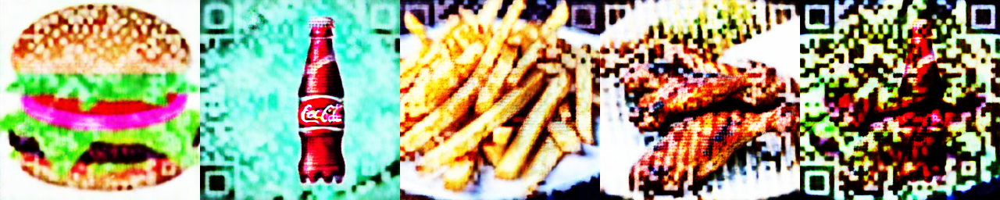

Status: : ETR=0:09:57.204503	ETA=0:31:05.681047	T=0:21:08.476544	Progress: 6799/10000

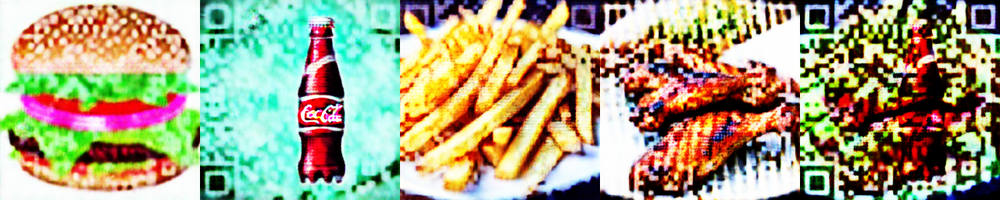

Status: : ETR=0:09:19.749010	ETA=0:31:05.208296	T=0:21:45.459287	Progress: 6999/10000

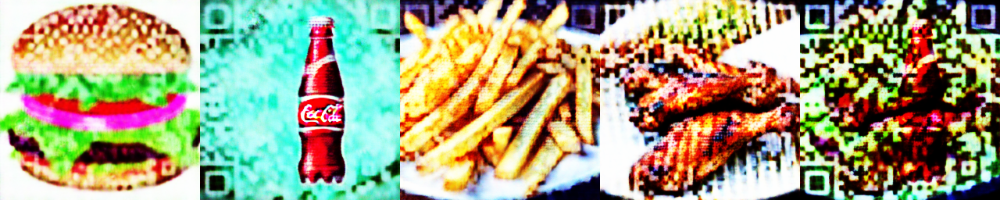

Status: : ETR=0:08:42.239727	ETA=0:31:04.476000	T=0:22:22.236272	Progress: 7199/10000

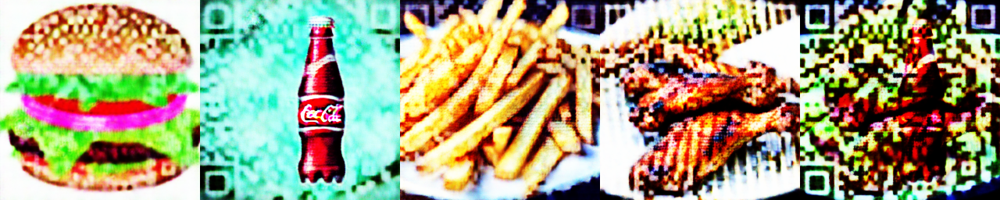

Status: : ETR=0:08:05.125128	ETA=0:31:05.148514	T=0:23:00.023385	Progress: 7399/10000

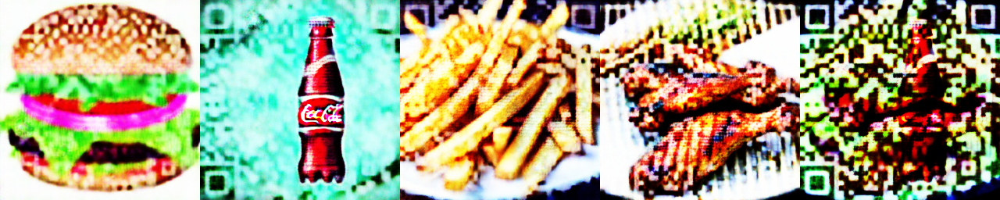

Status: : ETR=0:07:27.878149	ETA=0:31:05.381713	T=0:23:37.503564	Progress: 7599/10000

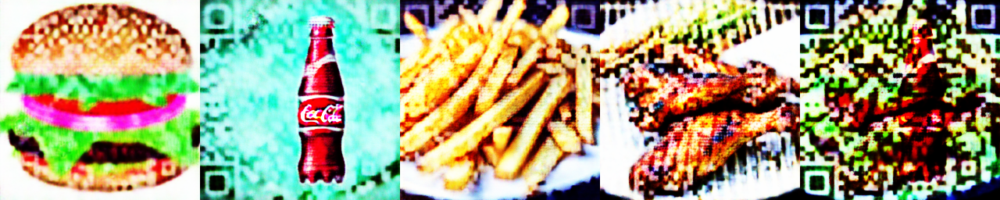

Status: : ETR=0:06:50.568354	ETA=0:31:05.371896	T=0:24:14.803542	Progress: 7799/10000

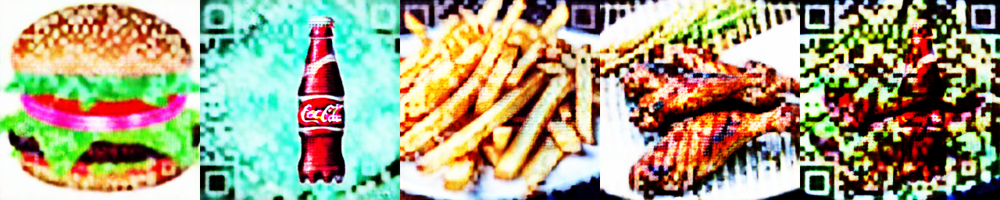

Status: : ETR=0:06:13.238594	ETA=0:31:05.260342	T=0:24:52.021748	Progress: 7999/10000

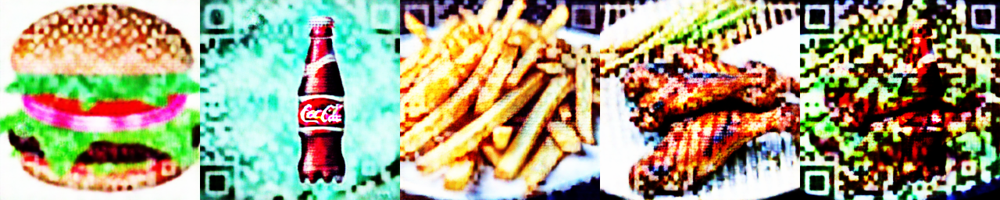

Status: : ETR=0:05:36.003047	ETA=0:31:06.683592	T=0:25:30.680545	Progress: 8200/10000

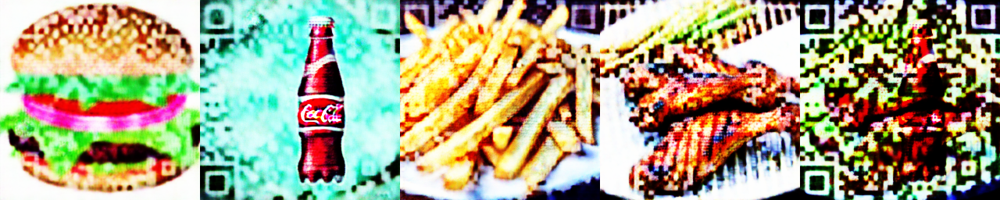

Status: : ETR=0:04:59.063604	ETA=0:31:07.980036	T=0:26:08.916432	Progress: 8399/10000

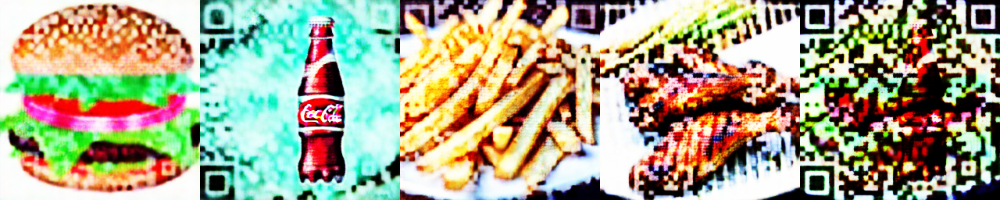

Status: : ETR=0:04:21.716644	ETA=0:31:08.070262	T=0:26:46.353618	Progress: 8599/10000

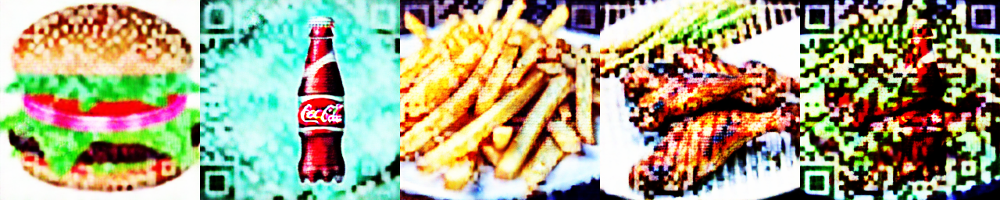

Status: : ETR=0:03:44.264900	ETA=0:31:07.318067	T=0:27:23.053167	Progress: 8799/10000

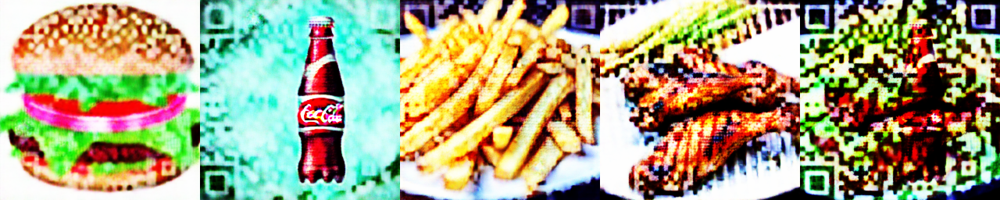

Status: : ETR=0:03:06.960689	ETA=0:31:07.739149	T=0:28:00.778460	Progress: 8999/10000

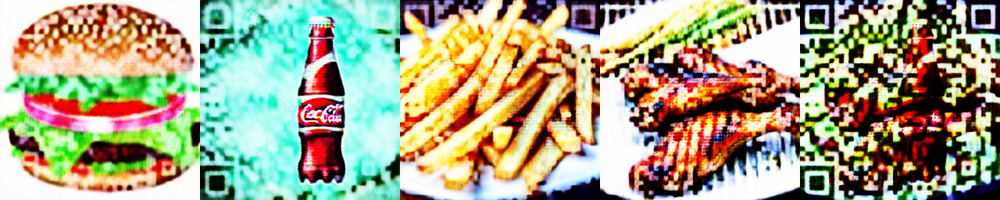

Status: : ETR=0:02:56.577409	ETA=0:31:08.544005	T=0:28:11.966597	Progress: 9055/10000
Interrupted early at iteration 9055


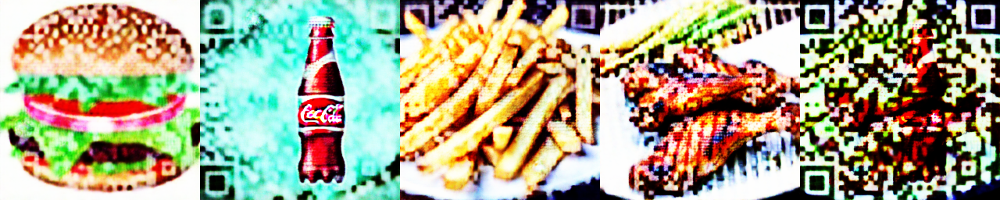

In [13]:
NUM_ITER=10000

#Set the minimum and maximum noise timesteps for the dream loss (aka score distillation loss)
s.max_step=MAX_STEP=990
s.min_step=MIN_STEP=10

display_eta=rp.eta(NUM_ITER, title='Status: ')

DISPLAY_INTERVAL = 200

print('Every %i iterations we display an image in the form [image_a, image_b, image_c, image_d, image_z] where'%DISPLAY_INTERVAL)
print('    image_z = image_a * image_b * image_c * image_d')
print()
print('Interrupt the kernel at any time to return the currently displayed image')
print('You can run this cell again to resume training later on')
print()
print('Please expect this to take hours to get good images (especially on the slower Colab GPU\'s! The longer you wait the better they\'ll be')

try:
    for iter_num in range(NUM_ITER):
        display_eta(iter_num) #Print the remaining time

        preds=[]
        for label,learnable_image,weight in rp.random_batch(list(zip(labels,learnable_images,weights)), batch_size=1):
            pred=s.train_step(
                label.embedding,
                learnable_image()[None],

                #PRESETS (uncomment one):
                # noise_coef=.1*weight,guidance_scale=60,#1
                # noise_coef=0,image_coef=-.01,guidance_scale=50,
                # noise_coef=0,image_coef=-.005,guidance_scale=50,
                # noise_coef=.1,image_coef=-.010,guidance_scale=50,
                # noise_coef=.1,image_coef=-.005*weight,guidance_scale=50,
                noise_coef=.1*weight,clip_coef=1.0,guidance_scale=50
            )
            preds+=list(pred)

        with torch.no_grad():
            if iter_num and not iter_num%(DISPLAY_INTERVAL*50):
                #Wipe the slate every 50 displays so they don't get cut off
                from IPython.display import clear_output
                clear_output()

            if not iter_num%DISPLAY_INTERVAL:
                im = get_display_image()
                ims.append(im)
                rp.display_image(im)

        optim.step()
        optim.zero_grad()
except KeyboardInterrupt:
    print()
    print('Interrupted early at iteration %i'%iter_num)
    im = get_display_image()
    ims.append(im)
    rp.display_image(im)